# Adversarial example using FGSM @ 2022
  ### Mohamed Ibn Khedher & Mounim A. El-Yacoubi

This tutorial creates an *adversarial example* using the Fast Gradient Signed Method (FGSM) attack as described in [Explaining and Harnessing Adversarial Examples](https://arxiv.org/abs/1412.6572) by Goodfellow *et al*. This was one of the first and most popular attacks to fool a neural network.


## What is an adversarial example?

Adversarial examples are specialised inputs created with the purpose of confusing a neural network, resulting in the misclassification of a given input. These notorious inputs are indistinguishable to the human eye, but cause the network to fail to identify the contents of the image. There are several types of such attacks, however, here the focus is on the fast gradient sign method attack, which is a *white box* attack whose goal is to ensure misclassification. A white box attack is where the attacker has complete access to the model being attacked. One of the most famous examples of an adversarial image shown below is taken from the aforementioned paper.

## Fast gradient sign method
The fast gradient sign method works by using the gradients of the neural network to create an adversarial example. For an input image, the method uses the gradients of the loss with respect to the input image to create a new image that maximises the loss. This new image is called the adversarial image. This can be summarised using the following expression:
$$adv\_x = x + \epsilon*\text{sign}(\nabla_xJ(\theta, x, y))$$

where

*   adv_x : Adversarial image.
*   x : Original input image.
*   y : Original input label.
*   $\epsilon$ : Multiplier to ensure the perturbations are small.
*   $\theta$ : Model parameters.
*   $J$ : Loss.

An intriguing property here, is the fact that the gradients are taken with respect to the input image. This is done because the objective is to create an image that maximises the loss. A method to accomplish this is to find how much each pixel in the image contributes to the loss value, and add a perturbation accordingly. This works pretty fast because it is easy to find how each input pixel contributes to the loss by using the chain rule and finding the required gradients. Hence, the gradients are taken with respect to the image. In addition, since the model is no longer being trained (thus the gradient is not taken with respect to the trainable variables, i.e., the model parameters), and so the model parameters remain constant. The only goal is to fool an already trained model.





#### The objective of this LAB is to try to fool a pretrained model by creating an adversarial images. In this tutorial, the model is [MobileNetV2](https://www.tensorflow.org/versions/r2.0/api_docs/python/tf/keras/applications/MobileNetV2) model, pretrained on [ImageNet](http://www.image-net.org/).

The LAB consists of the following steps
1. Load data: a pretrained model and an image
2. Implement the FGSM attack as described above
2. Apply a perturbation on the original image and observe the results

TODO :
1.	Generate adversarial images using different values of epsilon in the interval [0, 0.3] and observe the obtained images.
2.	What do you see if you increase the value of epsilon?
3.	Try to find empirically the maximum perturbation without fooling the model.
4.	Plot the probability of the correct class of the image according to the intensity of the attack. What do you notice?
5. This LAB is tested on one image "YellowLabradorLooking_new.jpg", but you can try to test other images like "grace_hopper.jpg", "elephant.jpg" and "tiger.jpg". To do this, you have to change the "image_path" variable in the "Load an original image" section.



## Import the needed packages

In [ ]:
import tensorflow as tf
import matplotlib as mpl
import matplotlib.pyplot as plt
import numpy as np

mpl.rcParams['figure.figsize'] = (8, 8)
mpl.rcParams['axes.grid'] = False

## Load a pretrained neural network model

In [ ]:
# load the pretrained MobileNetV2 model and the ImageNet class names.
pretrained_model = tf.keras.applications.MobileNetV2(include_top=True,
                                                   weights='imagenet')
pretrained_model.trainable = False

# ImageNet labels
decode_predictions = tf.keras.applications.mobilenet_v2.decode_predictions

14536120/14536120 [==============================] - 2s 0us/step


In [ ]:
# Helper function to preprocess the image so that it can be inputted in MobileNetV2
def preprocess(image):
  image = tf.cast(image, tf.float32)
  image = tf.image.resize(image, (224, 224))
  image = tf.keras.applications.mobilenet_v2.preprocess_input(image)
  image = image[None, ...]
  return image

# Helper function to extract labels from probability vector
def get_imagenet_label(probs):
  return decode_predictions(probs, top=1)[0][0]

## Load an original image

Let's use a sample image of a [Labrador Retriever](https://commons.wikimedia.org/wiki/File:YellowLabradorLooking_new.jpg) by Mirko [CC-BY-SA 3.0](https://creativecommons.org/licenses/by-sa/3.0/) from Wikimedia Common and create adversarial examples from it. The first step is to preprocess it so that it can be fed as an input to the MobileNetV2 model.

In [ ]:
#Load an image original

#image_path = tf.keras.utils.get_file('YellowLabradorLooking_new.jpg', 'https://storage.googleapis.com/download.tensorflow.org/example_images/YellowLabradorLooking_new.jpg')
#image_retriever_index = 208

#image_path = tf.keras.utils.get_file('grace_hopper.jpg', 'https://storage.googleapis.com/download.tensorflow.org/example_images/grace_hopper.jpg')
#image_retriever_index = 652

#image_path = tf.keras.utils.get_file('elephant.jpg', 'https://upload.wikimedia.org/wikipedia/commons/thumb/3/37/African_Bush_Elephant.jpg/375px-African_Bush_Elephant.jpg')
#image_retriever_index = 386

image_path = tf.keras.utils.get_file('tiger.jpg', 'https://upload.wikimedia.org/wikipedia/commons/thumb/4/41/Siberischer_tiger_de_edit02.jpg/640px-Siberischer_tiger_de_edit02.jpg')
image_retriever_index = 292


image_raw = tf.io.read_file(image_path)
image = tf.image.decode_image(image_raw)

#Predict its class
image = preprocess(image)
image_probs = pretrained_model.predict(image)

1/1 [==============================] - 7s 7s/step


# Display the original image

35363/35363 [==============================] - 0s 0us/step
('n02129604', 'tiger', 0.520771)


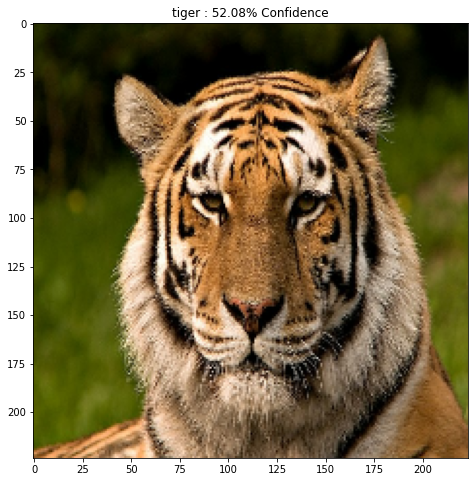

In [ ]:
plt.figure()
print(get_imagenet_label(image_probs))
plt.imshow(image[0]*0.5+0.5) # To change [-1, 1] to [0,1]
_, image_class, class_confidence = get_imagenet_label(image_probs)
plt.title('{} : {:.2f}% Confidence'.format(image_class, class_confidence*100))
plt.show()

## Create the adversarial image

 **Implementing fast gradient sign method**

The first step is to create perturbations which will be used to distort the original image resulting in an adversarial image. As mentioned, for this task, the gradients are taken with respect to the image.

In [ ]:
loss_object = tf.keras.losses.CategoricalCrossentropy()

def create_adversarial_pattern(input_image, input_label):
  with tf.GradientTape() as tape:
    tape.watch(input_image)
    prediction = pretrained_model(input_image)
    loss = loss_object(input_label, prediction)

  # Get the gradients of the loss w.r.t to the input image.
  gradient = tape.gradient(loss, input_image)
  # Get the sign of the gradients to create the perturbation
  signed_grad = tf.sign(gradient)
  return signed_grad

**Visualize the resulting perturbation**.

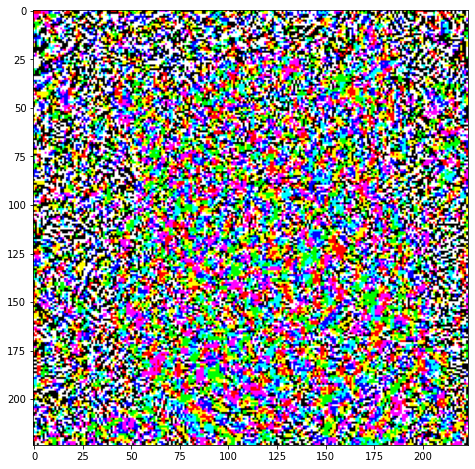

In [ ]:
# Get the input label of the image.

label = tf.one_hot(image_retriever_index, image_probs.shape[-1])
label = tf.reshape(label, (1, image_probs.shape[-1]))

perturbations = create_adversarial_pattern(image, label)
plt.imshow(perturbations[0]*0.5+0.5); # To change [-1, 1] to [0,1]

# Rania BEN KMICHA

**TODO :**
1.	Generate adversarial images using different values of epsilon in the interval [0, 0.3] and observe the obtained images.
2.	What do you see if you increase the value of epsilon?
3.	Try to find empirically the maximum perturbation without fooling the model.
4.	Plot the probability of the correct class of the image according to the intensity of the attack. What do you notice?

In [ ]:
def display_images(image, description):
  _, label, confidence = get_imagenet_label(pretrained_model.predict(image))
  plt.figure()
  plt.imshow(image[0]*0.5+0.5)
  plt.title('{} \n {} : {:.2f}% Confidence'.format(description,
                                                   label, confidence*100))
  plt.show()

In [ ]:
lis=np.arange(0.0,0.35,0.001,dtype=float)
list=lis.tolist()
print(type(list))
print(len(list))

<class 'list'>
350


1/1 [==============================] - 0s 17ms/step


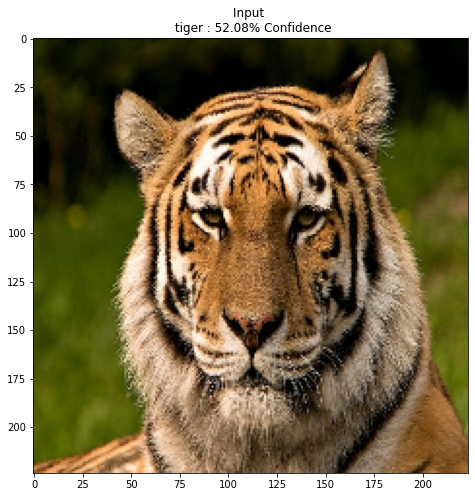

1/1 [==============================] - 0s 18ms/step


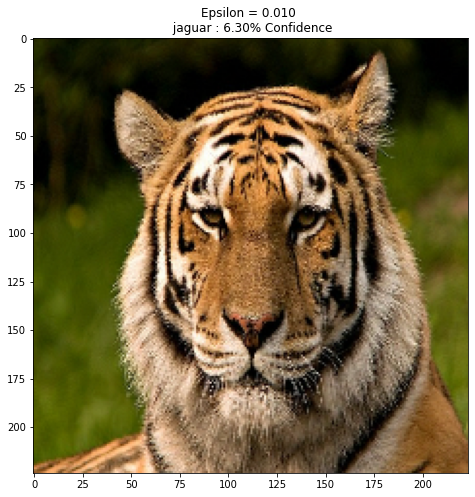

1/1 [==============================] - 0s 17ms/step


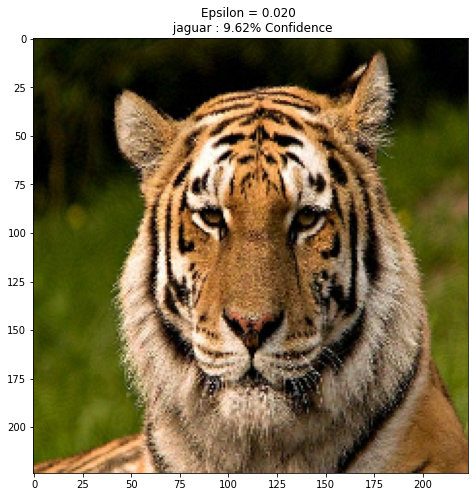

1/1 [==============================] - 0s 20ms/step


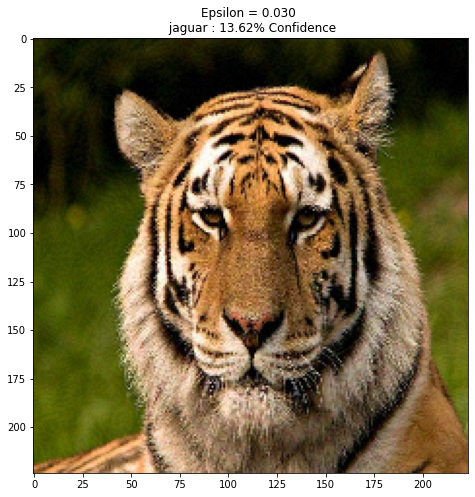

1/1 [==============================] - 0s 18ms/step


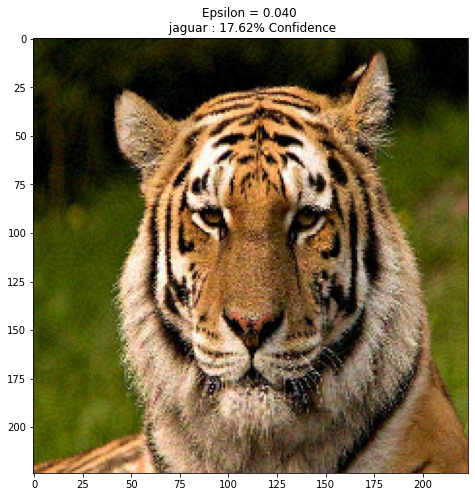

1/1 [==============================] - 0s 22ms/step


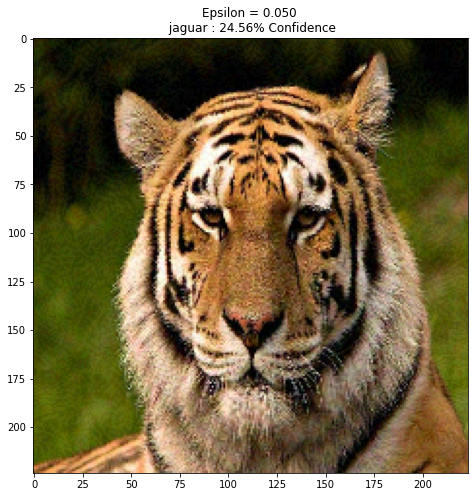

1/1 [==============================] - 0s 25ms/step


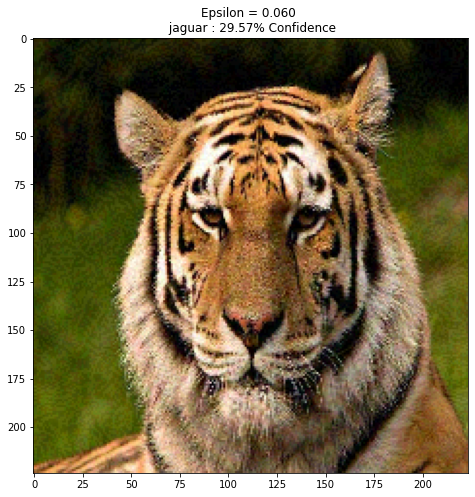

1/1 [==============================] - 0s 18ms/step


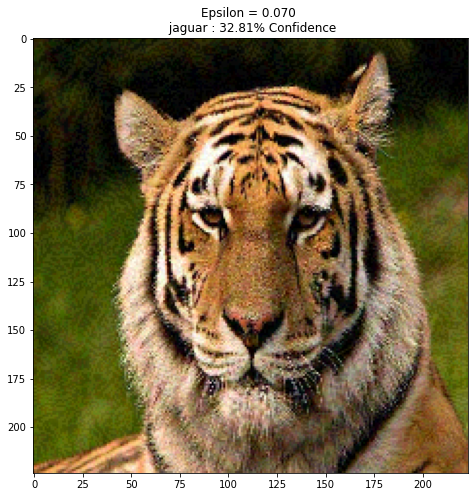

1/1 [==============================] - 0s 18ms/step


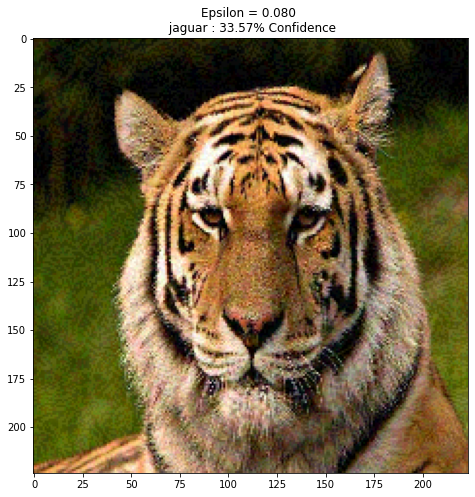

1/1 [==============================] - 0s 18ms/step


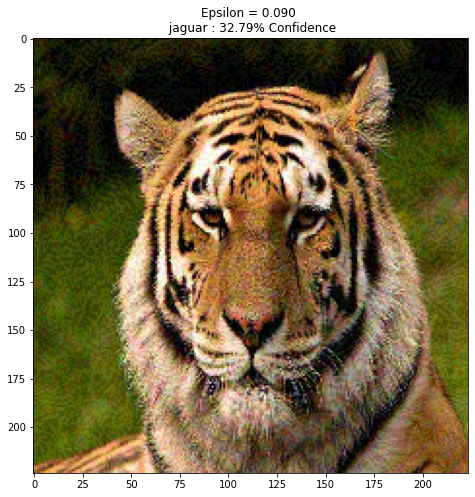

1/1 [==============================] - 0s 19ms/step


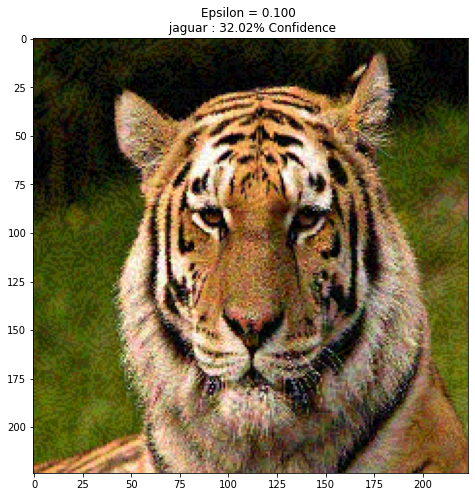

1/1 [==============================] - 0s 21ms/step


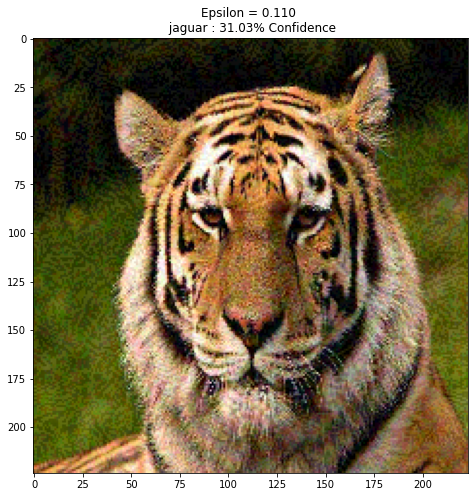

1/1 [==============================] - 0s 18ms/step


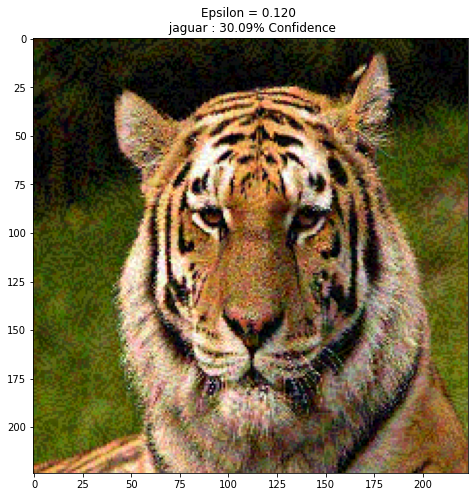

1/1 [==============================] - 0s 22ms/step


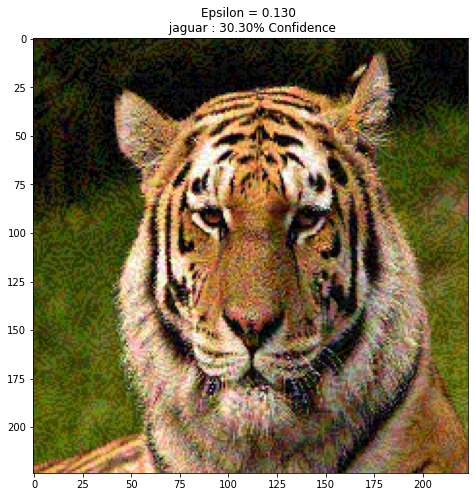

1/1 [==============================] - 0s 20ms/step


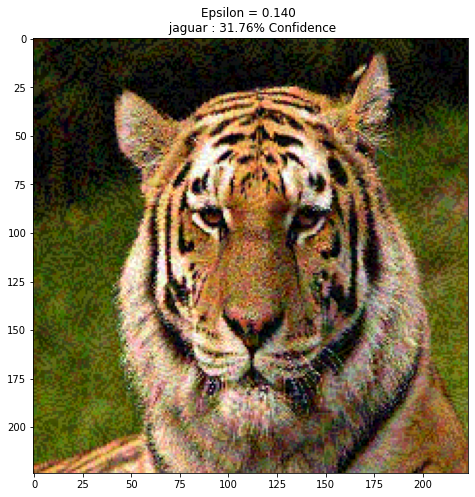

1/1 [==============================] - 0s 26ms/step


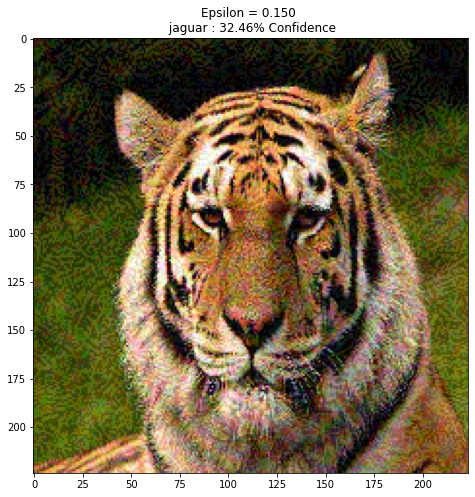

1/1 [==============================] - 0s 19ms/step


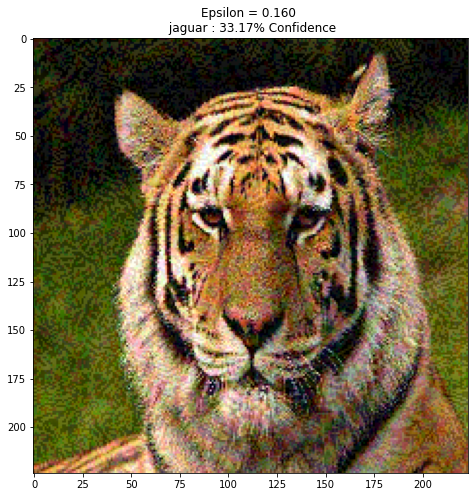

1/1 [==============================] - 0s 30ms/step


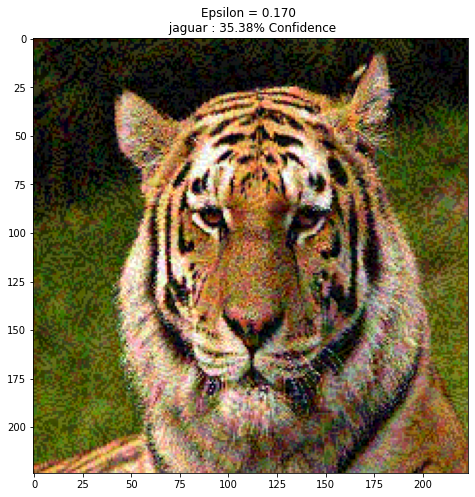

1/1 [==============================] - 0s 31ms/step


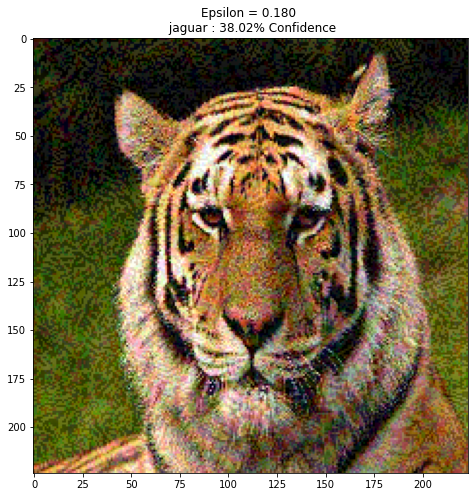

1/1 [==============================] - 0s 29ms/step


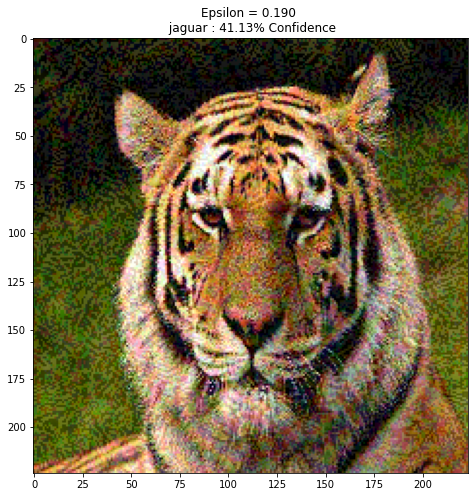

1/1 [==============================] - 0s 30ms/step


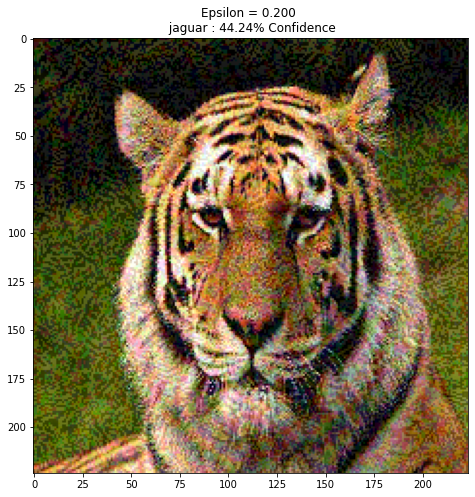

1/1 [==============================] - 0s 25ms/step


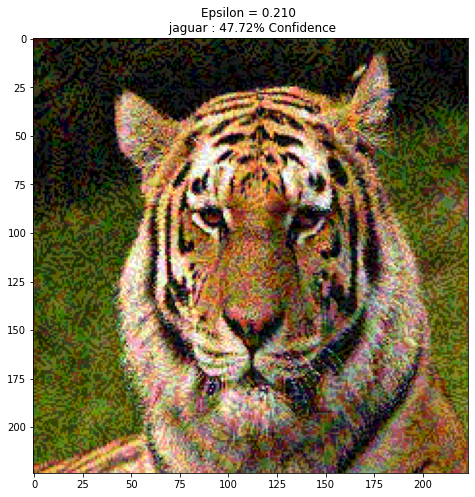

1/1 [==============================] - 0s 35ms/step


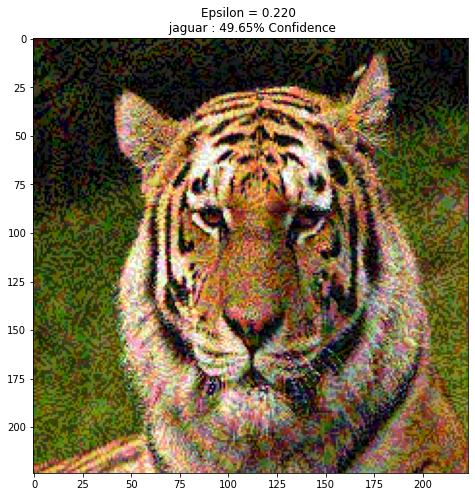

1/1 [==============================] - 0s 25ms/step


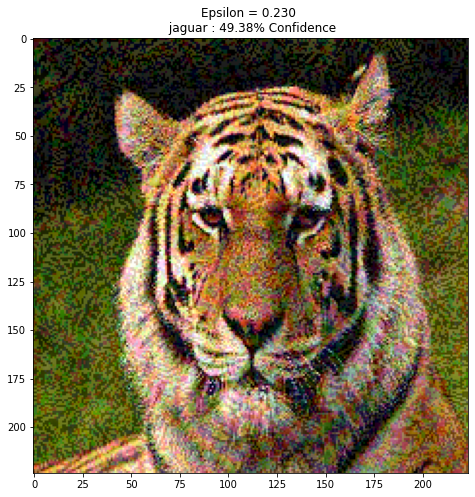

1/1 [==============================] - 0s 25ms/step


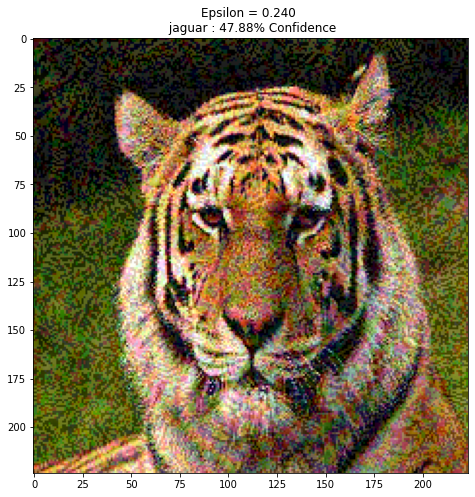

1/1 [==============================] - 0s 26ms/step


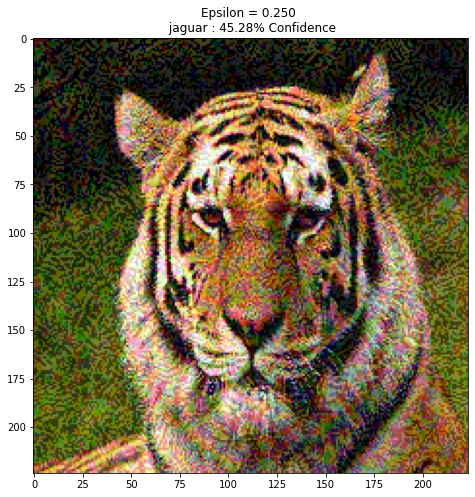

1/1 [==============================] - 0s 26ms/step


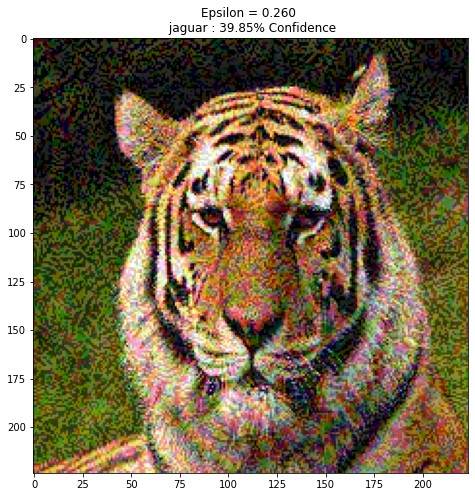

1/1 [==============================] - 0s 26ms/step


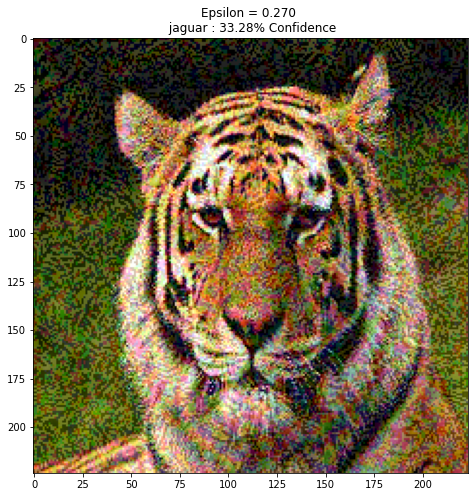

1/1 [==============================] - 0s 40ms/step


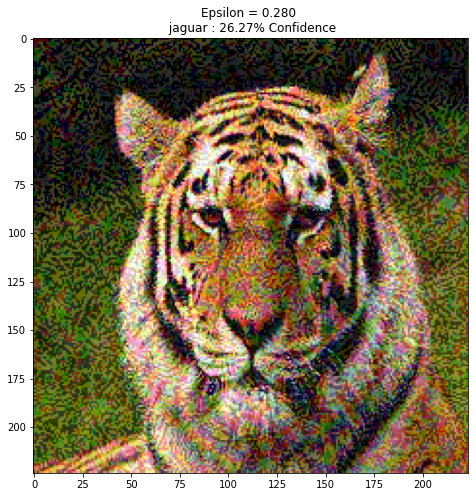

1/1 [==============================] - 0s 26ms/step


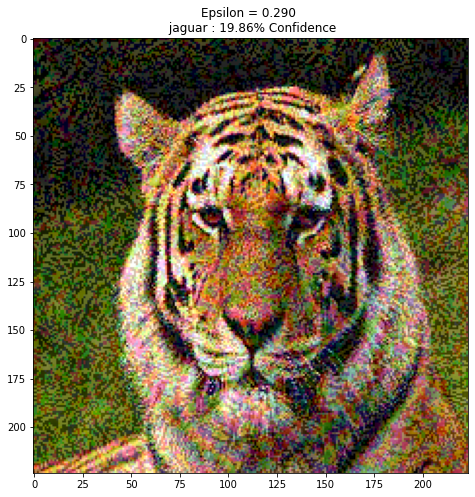

1/1 [==============================] - 0s 25ms/step


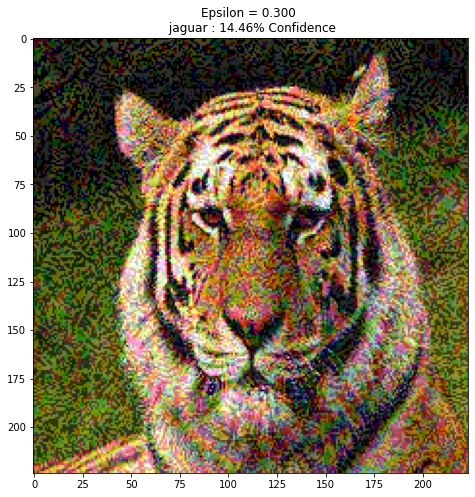

In [ ]:
epsilons = np.arange(0.0,0.31,0.01).tolist()
descriptions = [('Epsilon = {:0.3f}'.format(eps) if eps else 'Input')
                for eps in epsilons]

for i, eps in enumerate(epsilons):
  adv_x = image + eps*create_adversarial_pattern(image,label)
  adv_x = tf.clip_by_value(adv_x, -1, 1)
  #print(adv_x[0,0])
  display_images(adv_x, descriptions[i])

# TODO: why the image is clipped between -1 and 1 ?
#The image is clipped between -1 an 1 to be prepared as an input image to the pretrained model(neural network) and to be displayed by the imshow function of course.

#Observation:
*1)When we increase slowly the Epsilon's value, we observe that the image's quality diminishes.Moreover, when we add the perturpation to input image,the model misclassify it to represent then a jaguar class instead of tiger class .


*2) The confidence of juguar class is increasing by epsilon value to reach its maximum by 45.28% for 0.25 epsilon's value.At this moment the Confidence start to decrease to reach 14/% for epsilon=0.3 maintaining the jaguar class as an ouput of the model.


# 3) Trying to find empirically the maximum perturbation without fooling the model:

1/1 [==============================] - 0s 29ms/step


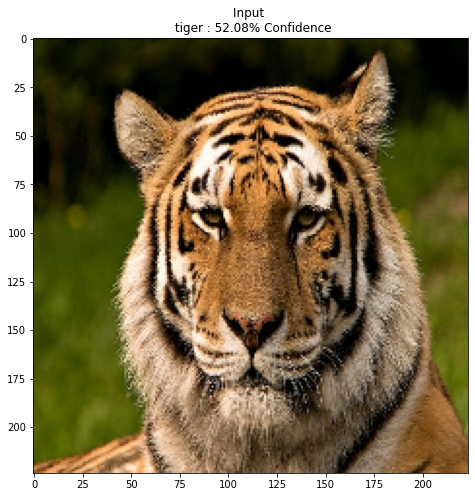

1/1 [==============================] - 0s 19ms/step


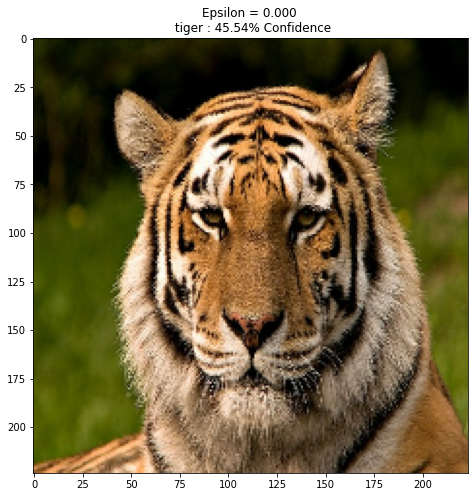

1/1 [==============================] - 0s 18ms/step


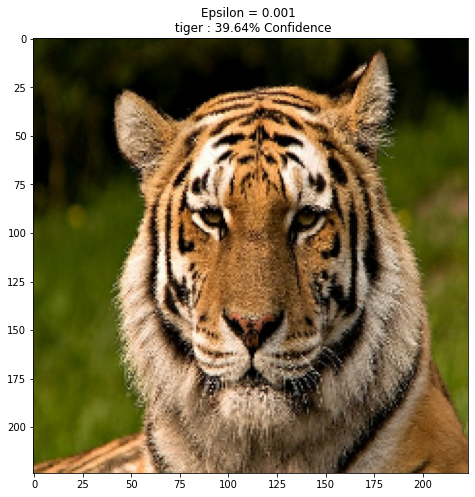

1/1 [==============================] - 0s 19ms/step


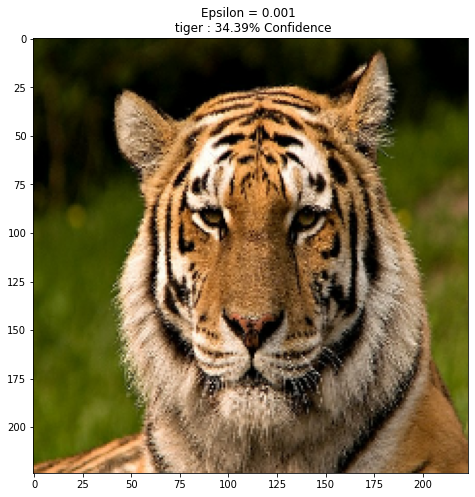

1/1 [==============================] - 0s 19ms/step


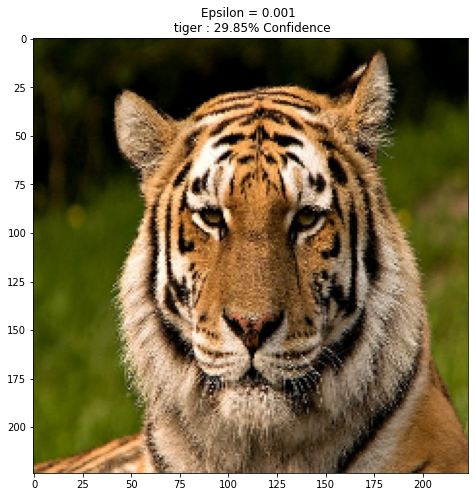

1/1 [==============================] - 0s 23ms/step


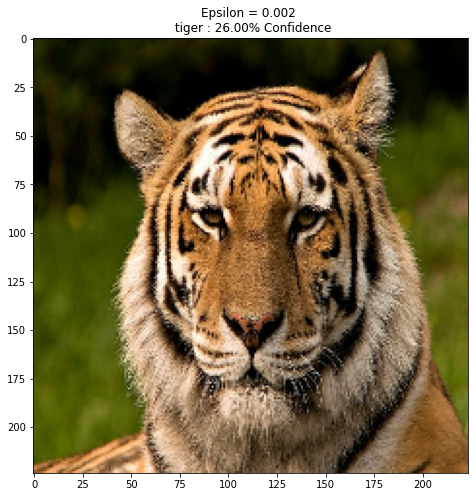

1/1 [==============================] - 0s 26ms/step


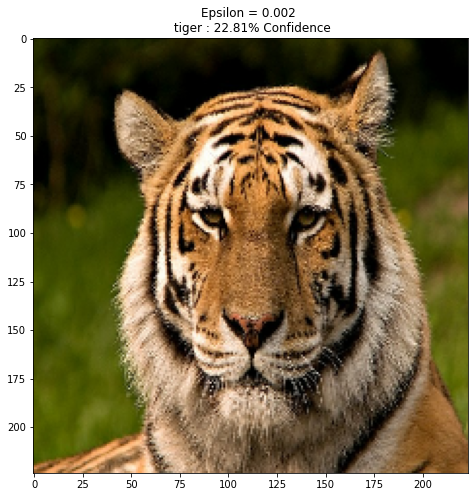

1/1 [==============================] - 0s 34ms/step


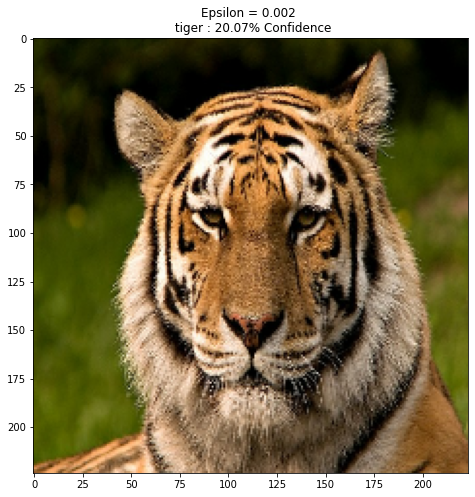

1/1 [==============================] - 0s 29ms/step


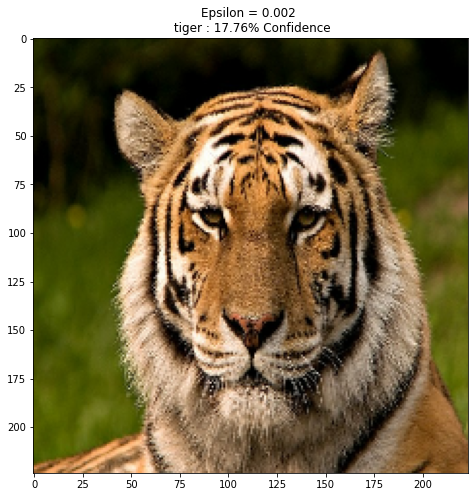

1/1 [==============================] - 0s 30ms/step


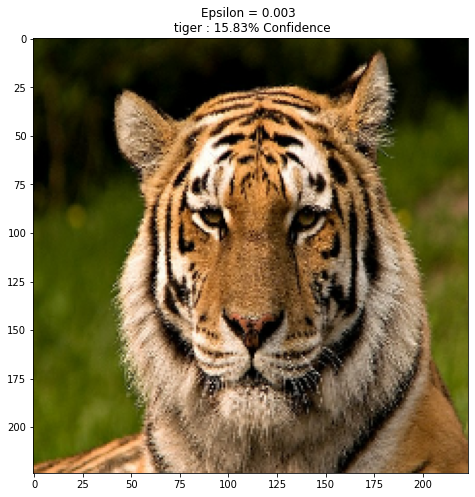

1/1 [==============================] - 0s 26ms/step


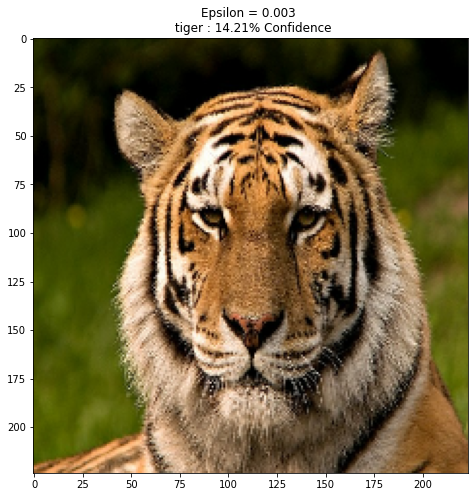

1/1 [==============================] - 0s 27ms/step


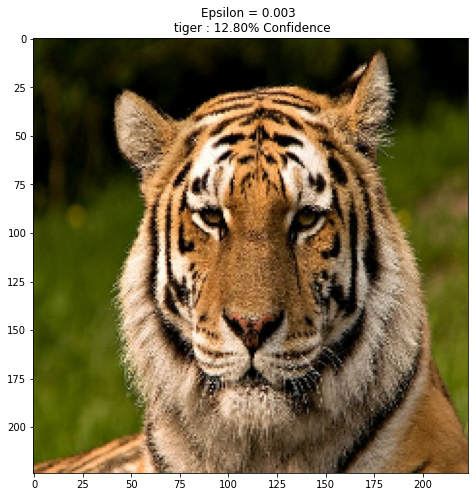

1/1 [==============================] - 0s 27ms/step


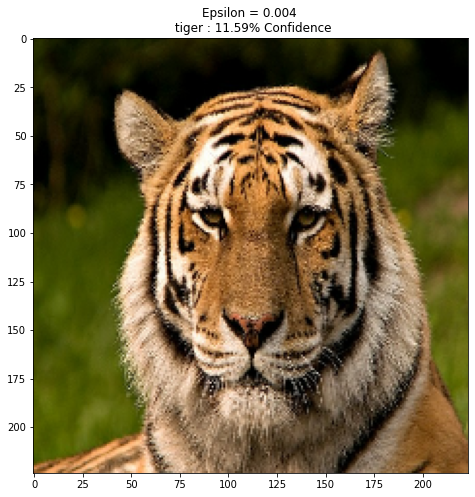

1/1 [==============================] - 0s 29ms/step


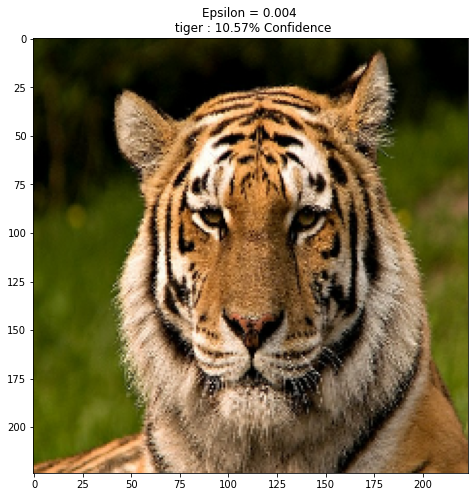

1/1 [==============================] - 0s 26ms/step


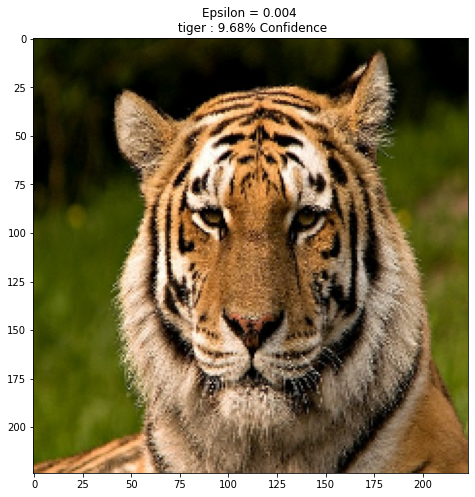

1/1 [==============================] - 0s 28ms/step


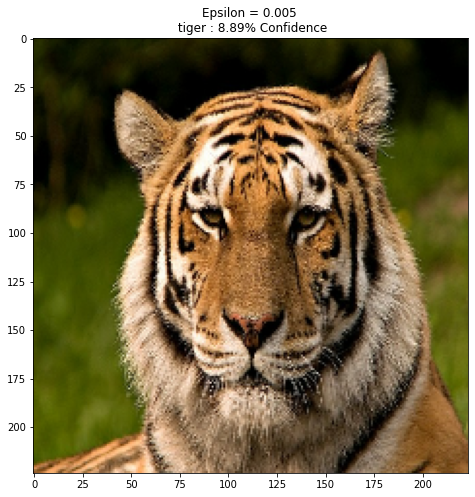

1/1 [==============================] - 0s 27ms/step


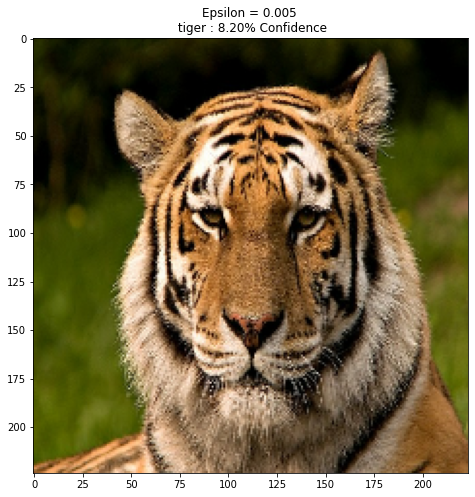

1/1 [==============================] - 0s 25ms/step


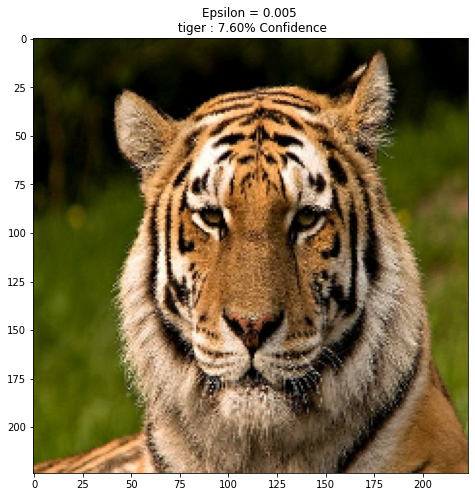

1/1 [==============================] - 0s 27ms/step


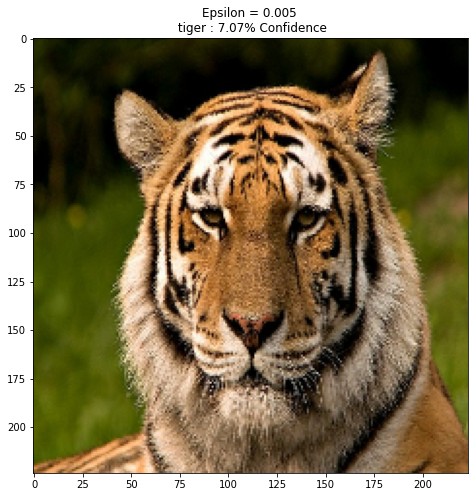

1/1 [==============================] - 0s 36ms/step


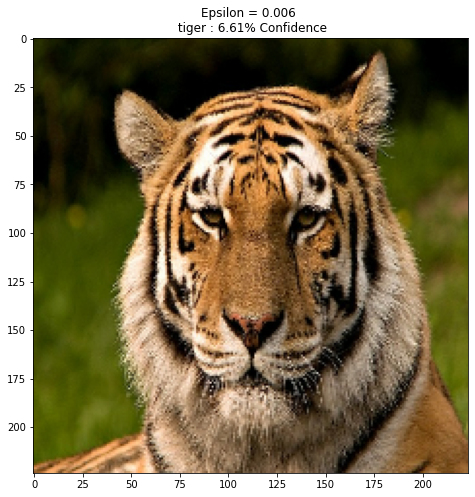

1/1 [==============================] - 0s 26ms/step


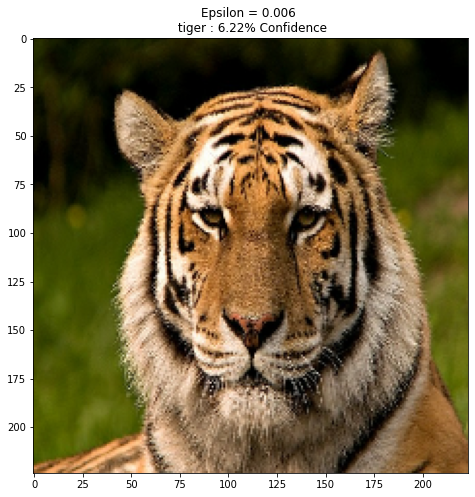

1/1 [==============================] - 0s 25ms/step


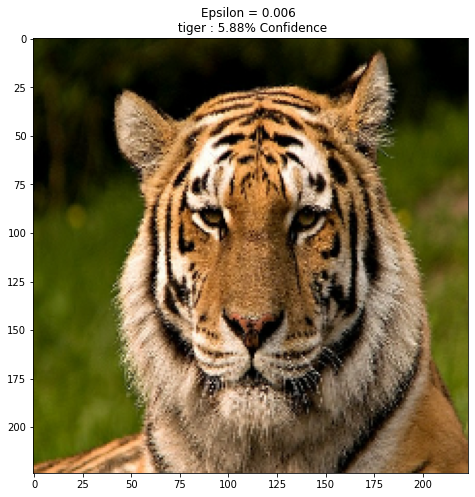

1/1 [==============================] - 0s 22ms/step
the maximum perturbation without fooling the model found for epsilon  0.006606606606606606


In [ ]:
epsilons =np.linspace(0, 0.3, num=1000)
#np.arange(0.0,0.35,0.000001).tolist()
maximum_perturbation_vl_eps=0
descriptions = [('Epsilon = {:0.3f}'.format(eps) if eps else 'Input')
                for eps in epsilons]

label_original_string= get_imagenet_label(pretrained_model.predict(image))[1]
for i, eps in enumerate(epsilons):
  adv_x = image + eps*create_adversarial_pattern(image,label)
  adv_x = tf.clip_by_value(adv_x, -1, 1)
  label_adv = get_imagenet_label(pretrained_model.predict(adv_x))[1]
  maximum_perturbation_vl_eps=eps
  if (label_adv!=label_original_string):
    print("the maximum perturbation without fooling the model found for epsilon ",maximum_perturbation_vl_eps)
    break
  display_images(adv_x, descriptions[i])










When we try to increase the epsilon 's value slowly for 1000 samples ,we took the maximum one when the input become misclassified.

The maximum perturbation without fooling the model was found for an epsilon equal to   0.006606606606606606

**TODO: Plot the probability of the correct class of the image according to the intensity of the attack**

1/1 [==============================] - 0s 25ms/step
0.520771
1/1 [==============================] - 0s 18ms/step
0.14069468
1/1 [==============================] - 0s 17ms/step
0.06152882
1/1 [==============================] - 0s 17ms/step
0.04041567
1/1 [==============================] - 0s 18ms/step
0.031233918
1/1 [==============================] - 0s 18ms/step
0.026005024
1/1 [==============================] - 0s 18ms/step
0.024040809
1/1 [==============================] - 0s 18ms/step
0.023609629
1/1 [==============================] - 0s 17ms/step
0.023179771
1/1 [==============================] - 0s 16ms/step
0.021460123
1/1 [==============================] - 0s 17ms/step
0.01921962
1/1 [==============================] - 0s 17ms/step
0.018093873
1/1 [==============================] - 0s 17ms/step
0.016851913
1/1 [==============================] - 0s 17ms/step
0.015861055
1/1 [==============================] - 0s 18ms/step
0.015283301
1/1 [==============================] - 0s 18ms/

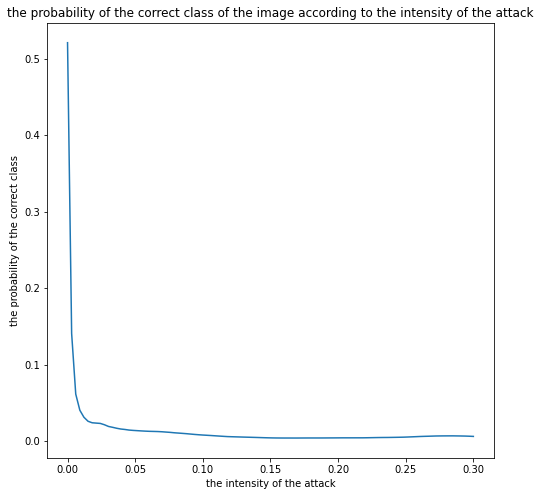

In [ ]:
# The probability of the correct class is saved  in  image_probs[0][208]

epsilons = np.linspace(0, 0.3, num=100)
descriptions = [('Epsilon = {:0.3f}'.format(eps) if eps else 'Input')
                for eps in epsilons]
list_prob=[]
for i, eps in enumerate(epsilons):
  adv_x = image + eps*create_adversarial_pattern(image,label)
  adv_x = tf.clip_by_value(adv_x, -1, 1)
  image_probs = pretrained_model.predict(adv_x)
  print(image_probs[0][image_retriever_index])
  list_prob.append(image_probs[0][image_retriever_index])
plt.plot(epsilons,list_prob)
plt.title("the probability of the correct class of the image according to the intensity of the attack")
plt.xlabel("the intensity of the attack")
plt.ylabel("the probability of the correct class")
plt.show()

#Question4:
So as mentioned above in question 1, the increase of Epsilon value engender the decrease of the probbability of the correct class "Tiger" until we reach a minimum value for which the maximum probability will belong to  the  jaguar class.